# UNET

In [1]:
import numpy as np
from keras.models import Sequential
from keras.layers import Conv2D, UpSampling2D, MaxPooling2D
from keras.layers.core import Activation, Dense, Flatten
from keras.optimizers import SGD
from keras.callbacks import ModelCheckpoint
from keras.models import load_model, save_model
import matplotlib.pyplot as plt
%matplotlib inline
from keras.layers.convolutional import Conv1D, MaxPooling1D
from matplotlib.colors import LinearSegmentedColormap
from timeit import default_timer as timer
import os
from keras.models import Model
from keras.layers import Input, merge, ZeroPadding2D, concatenate, BatchNormalization
from keras.layers.core import Dropout
from skimage.color import rgb2lab, lab2rgb
import h5py
from timeit import default_timer as timer
import math
from keras import backend as K
from keras.utils.generic_utils import get_custom_objects
from keras.callbacks import ModelCheckpoint, CSVLogger, Callback
import tensorflow as tf

C:\ProgramData\Anaconda3\lib\site-packages\h5py\__init__.py:36: FutureWarning: Conversion of the second argument of issubdtype from `float` to `np.floating` is deprecated. In future, it will be treated as `np.float64 == np.dtype(float).type`.
  from ._conv import register_converters as _register_converters
Using TensorFlow backend.


In [2]:
# yields a batch for neural neetwork
# X_batch: L channel of images - from where our network will predict color channels
# Y_batch: A and B channels of images - the real (desired) color values
def generatorLab(h5dataset, batch_size = 32, seed = 1):
    indices = list(range(h5dataset.shape[0])) # array of the indices
    while True: # infinite generator
        np.random.seed(seed) # set seed so shuffle will be repeatable
        np.random.shuffle(indices) # shuffle before every epoch
        for i in range(0, len(indices) - batch_size + 1, batch_size):
            batch_indices = sorted(indices[i:i+batch_size]) # only sorted list can index more elements at once
            lab_batch = h5dataset[batch_indices] # get LAB pictures from dataset
            X_batch = lab_batch[:,:,:,0:1]/100 # scale inputs (L layer)
            Y_batch = (lab_batch[:,:,:,1:3] +128) / 255 # scale outputs (A and B layers)
            yield (X_batch,Y_batch)
            
# plots the original pictures, the predicted ones by model, and the inputs
def plot_results(model, picture):
    preds = model.predict(picture[:,:,:,0:1]) # predicting A and B channels
    preds = np.concatenate((picture[:,:,:,0:1],preds),axis=3) # adding the L channel (input) to the picture
    plt.rcParams["figure.figsize"] = [15,10] # bigger plot size
    
    for ind in range(picture.shape[0]): # iterating over all pictures
        
        # plot original
        plt.subplot(131) # 1 row, 3 column, 1st picture
        plt.title('Original')
        plt.grid(False) # no grid
        plt.axis('off') # no axes
        plt.imshow(lab2rgb(outputscaler(picture[ind]))) 

        # plot predicted
        plt.subplot(132) # 1 row, 3 column, 2nd picture
        plt.title('Predicted')
        plt.grid(False) # no grid
        plt.axis('off') # no axes
        plt.imshow(lab2rgb(outputscaler(preds[ind]))) 

        # plot black and white
        plt.subplot(133) # 1 row, 3 column, 3rd picture
        plt.title('Black&White')
        plt.grid(False) # no grid
        plt.axis('off') # no axes
        cmL = LinearSegmentedColormap.from_list('L channel', [(0, 0, 0), (1, 1, 1)], N=101)
        plt.imshow(picture[ind,:,:,0], cmap=cmL, vmin = 0, vmax = 1) # cmL is a colormap for L channel
        
        plt.show()


# upscales our normalized image
# funtcion of min-max scaling: y = (x-min(x))/(max(x)-min(x))
# so the reversed is: x = y*(max(x)-min(x)) + min(x)
def outputscaler(img):
    ret = np.zeros(img.shape) # allocate space for return data
    ret[:,:,0] = np.round(img[:,:,0]*100)     # L channel goes from 0 - +100
    ret[:,:,1:3] = np.round((img[:,:,1:3]*255))-128 # A and B channels range is from -128 to +127
    return ret

In [3]:
h5Lab = h5py.File('data/allDataLab.h5') # load our dataset

In [4]:
# custom Callback function
# after every epoch saves the model with unique name
class CheckPointer(Callback):
    
    # net_name: name of the network, it will be used for save directory and file name too
    # path: base path for the output
    # nb: length of number indicating version (because: '10' is before '2', so we save as '02')
    def __init__(self, net_name, path = 'weights/', nb = 2):
        # append a '/' to the end of path if there isn't any yet
        if path[-1] is not '/':
            path += '/'
        
        self.net_name = net_name.upper() # using uppercases, so net_name is not case sensitive
        self.path = path + self.net_name + '/' # create path to the folder where models will be saved
        self.nb = nb
        # if the output folder doesn't exist create it
        if not os.path.exists(self.path):
            os.makedirs(self.path)
    
    # this function is called after every epoch
    def on_epoch_end(self, batch, logs={}):
        # list of previos saved networks
        previous_nets = [x for x in os.listdir(self.path) if self.net_name in x]
        if len(previous_nets) == 0: # if there were no previous, this is the first
            last_number = 0 # so set last number to 0
        else: # if there were some previous networks
            # get last number from the last network name from the previous_nets list
            last_number = int(previous_nets[-1][len(self.net_name) + 1:len(self.net_name) + 1 + self.nb])
        new_number = str(last_number + 1) # new number is the last number plus one, and converted to string
        while len(new_number) < self.nb: # while our number doesn't have enough digits
            new_number = '0' + new_number # append a zero to the left
        # our output model name will be: 'NETNAME_XX.hdf5'
        model_name = self.net_name + '_' + new_number + '.hdf5'
        # save model to the appropriate folder with the appropriate name
        save_model(self.model, self.path + model_name)
        # print some feedback
        print('Model saved:', self.path + model_name)

# loads the last model with the given name
# saved models should follow the naming method of 'CheckPointer'
# net_name: name of the net
def loadLastModel(net_name):
    net_name = net_name.upper() # using uppercases, so net_name is not case sensitive
    # list of previous saved networks
    previous_nets = [x for x in os.listdir('weights/' + net_name + '/') if net_name in x]
    if len(previous_nets) == 0: # if there were no previous
        # print some feedback
        print('ERROR: There is no previous models with this name:', net_name)
    else: # if we have at least one previous model
        # print some feedback
        print('Loading model:', previous_nets[-1])
        # return with the loaded model
        # path: 'weights/NETNAME/NETNAME_XX.hdf5'
        return load_model('weights/' + net_name + '/' + previous_nets[-1])

We tried out some loss functions too. Structural similarity (SSIM) works pretty well. More about SSIM can be found in [this study](http://www.cns.nyu.edu/pub/lcv/wang03-preprint.pdf) .

In [5]:
# defining new loss function for keras
def SSIMLoss(y_true, y_pred):
    # SSIM gives higher number for better similarity, so we need the opposite of it
    return 1 - tf.image.ssim(y_true, y_pred, 1)
# add loss function to keras
get_custom_objects().update({"SSIMLoss": SSIMLoss})

In [6]:
# creating an Unet
# more about the network can be found in our documentation

inputs = Input((128,128,1))
# encoder part
conv1 = Conv2D(32, (3, 3), padding='same')(inputs)
conv1 = BatchNormalization(axis = 3, momentum = 0.9)(conv1)
conv1 = Activation('relu')(conv1)

conv2 = Conv2D(64, (3, 3), padding='same', strides=2)(conv1)
conv2 = BatchNormalization(axis = 3, momentum = 0.9)(conv2)
conv2 = Activation('relu')(conv2)

conv3 = Conv2D(128, (3, 3), padding='same', strides=2)(conv2)
conv3 = BatchNormalization(axis = 3, momentum = 0.9)(conv3)
conv3 = Activation('relu')(conv3)

conv4 = Conv2D(256, (3, 3), padding='same', strides=2)(conv3)
conv4= BatchNormalization(axis = 3, momentum = 0.9)(conv4)
conv4 = Activation('relu')(conv4)

conv5 = Conv2D(512, (3, 3), padding='same', strides=2)(conv4)
conv5 = BatchNormalization(axis = 3, momentum = 0.9)(conv5)
conv5 = Activation('relu')(conv5)

# decoder part
concat1 = concatenate([UpSampling2D((2, 2))(conv5), conv4], axis = 3)
conv6 = Conv2D(128, (3, 3), padding='same')(concat1)
conv6 = BatchNormalization(axis = 3, momentum = 0.9)(conv6)
conv6 = Activation('relu')(conv6)

concat2 = concatenate([UpSampling2D((2, 2))(conv6), conv3], axis = 3)
conv7 = Conv2D(64, (3, 3), padding='same')(concat2)
conv7 = BatchNormalization(axis = 3, momentum = 0.9)(conv7)
conv7 = Activation('relu')(conv7)

concat3 = concatenate([UpSampling2D((2, 2))(conv7), conv2], axis = 3)
conv8 = Conv2D(32, (3, 3), padding='same')(concat3)
conv8 = BatchNormalization(axis = 3, momentum = 0.9)(conv8)
conv8 = Activation('relu')(conv8)

concat4 = concatenate([UpSampling2D((2, 2))(conv8), conv1], axis = 3)
conv9 = Conv2D(32, (3, 3), padding='same')(concat4)
conv9 = BatchNormalization(axis = 3, momentum = 0.9)(conv9)
conv9 = Activation('relu')(conv9)

conv10 = Conv2D(2, (3, 3), padding='same')(conv9)
conv10 = BatchNormalization(axis = 3, momentum = 0.9)(conv10)
conv10 = Activation('relu')(conv10)

concat5 = concatenate([conv10,inputs], axis = 3)
conv11 =  Conv2D(2, (1, 1), activation='sigmoid', padding='same')(concat5)

unet4 = Model(inputs, conv11)

unet4.compile(optimizer='adam', loss='mae') # we used mean absolute error at the beginning

unet4.summary()

__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_1 (InputLayer)            (None, 128, 128, 1)  0                                            
__________________________________________________________________________________________________
conv2d_1 (Conv2D)               (None, 128, 128, 32) 320         input_1[0][0]                    
__________________________________________________________________________________________________
batch_normalization_1 (BatchNor (None, 128, 128, 32) 128         conv2d_1[0][0]                   
__________________________________________________________________________________________________
activation_1 (Activation)       (None, 128, 128, 32) 0           batch_normalization_1[0][0]      
__________________________________________________________________________________________________
conv2d_2 (

In [7]:
#after 24 epochs with mae, we tried out SSIM too
# unet4 = loadLastModel('unet4') # uncomment to load previous model
# unet4.compile(optimizer = 'adam', loss = SSIMLoss) # uncomment to change loss to SSIM

train_gen = generatorLab(h5Lab['train'], batch_size = 64) # create train data generator
valid_gen = generatorLab(h5Lab['valid'], batch_size = 64) # create validation data generator

# teaching the network
unet4.fit_generator(train_gen, steps_per_epoch = h5Lab['train'].shape[0]//64, epochs = 1,
                    validation_data = valid_gen, validation_steps = h5Lab['valid'].shape[0]//64,
                    callbacks = [CheckPointer('unet4'),
                                 CSVLogger('logs/unet4.csv', append=True, separator=',')])

Loading model: UNET4_72.hdf5
Epoch 1/1
2639/2639 [==============================] - 1621s 614ms/step - loss: 0.0549 - val_loss: 0.0666
Model saved: weights/UNET4/UNET4_73.hdf5


Loading model: UNET4_73.hdf5


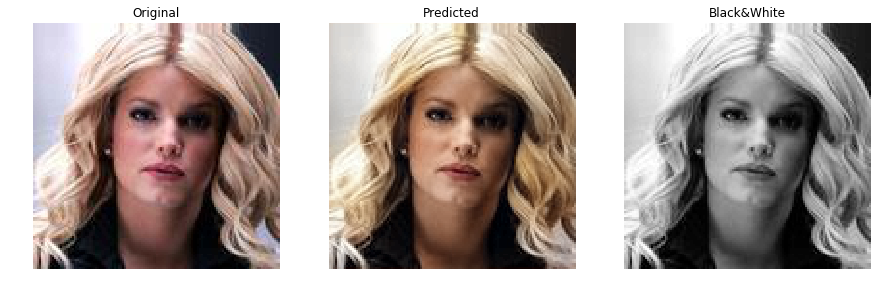

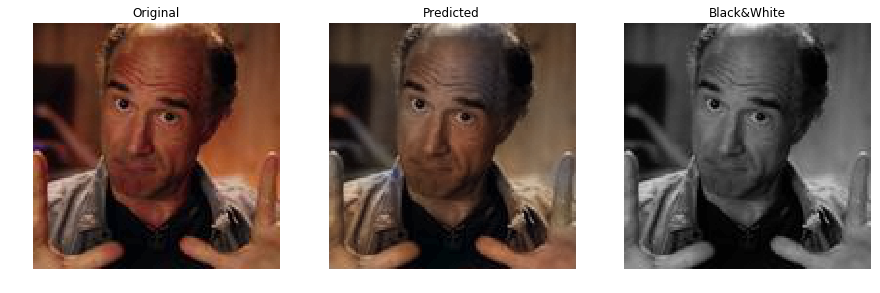

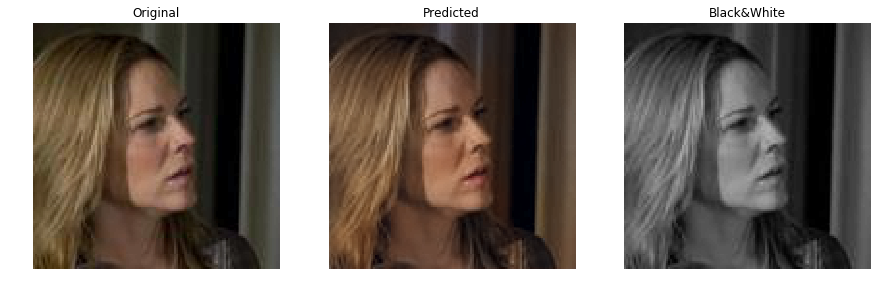

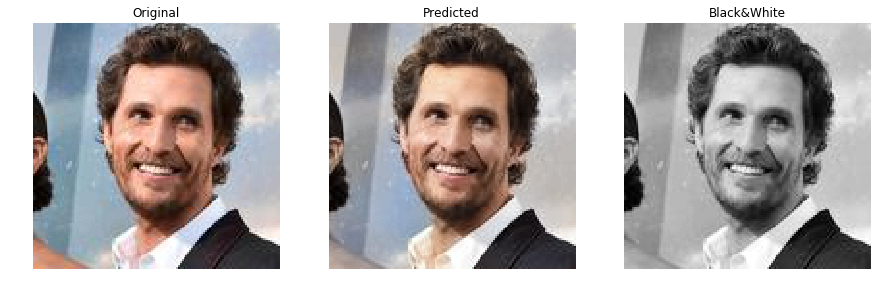

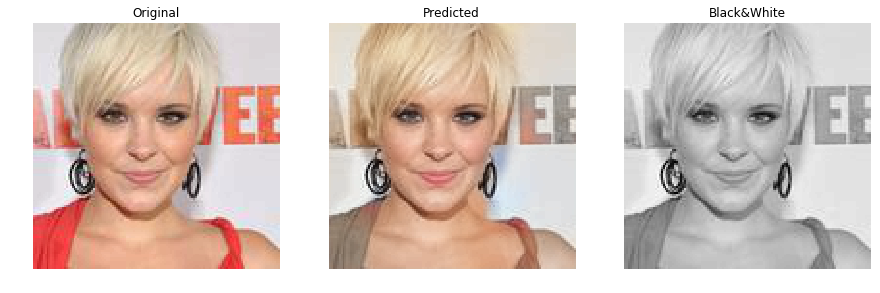

...

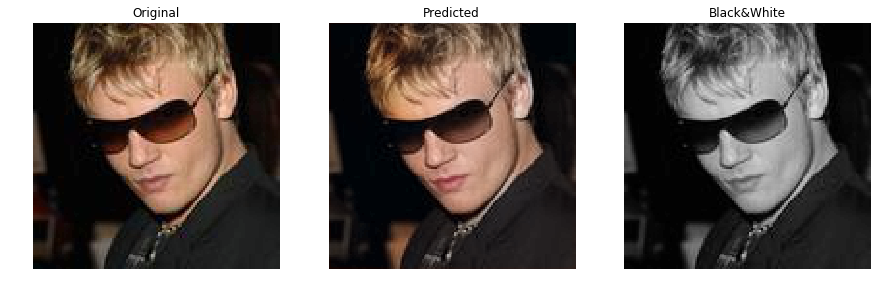

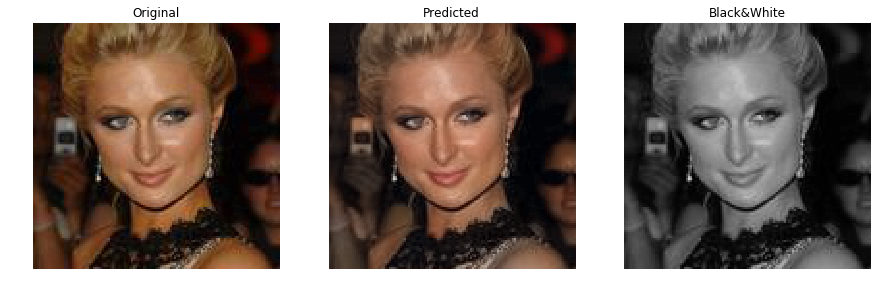

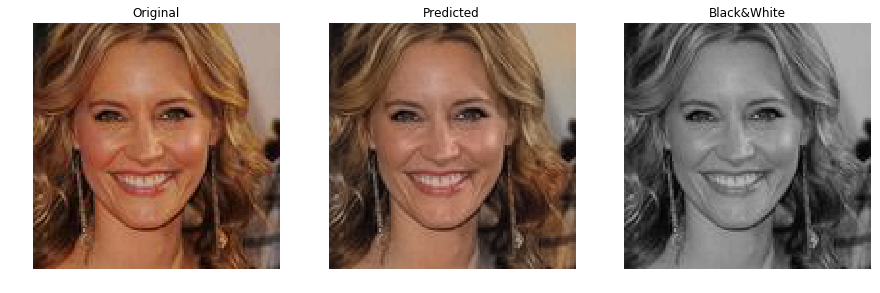

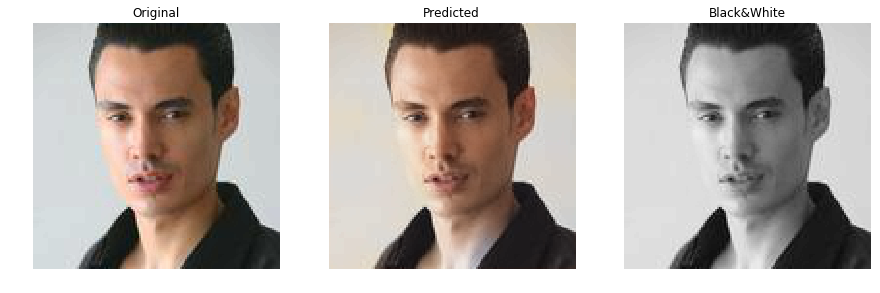

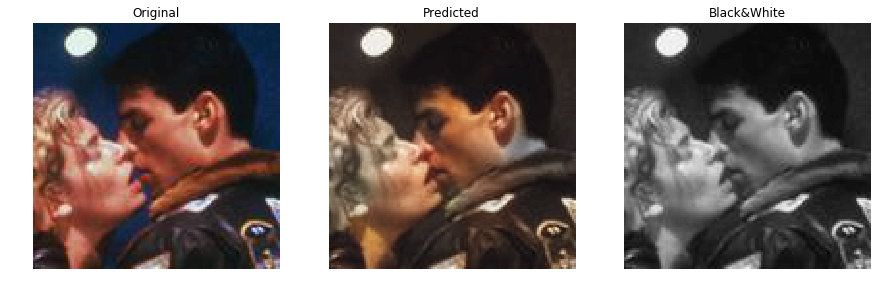

In [8]:
unet4 = loadLastModel('unet4')
test = h5Lab['test'][0:200].astype(np.float32)
test[:,:,:,0] = test[:,:,:,0]/100 # L channel
test[:,:,:,1:3] = (test[:,:,:,1:3] + 128)/255 # A and B channels
plot_results(unet4, test)